<a href="https://colab.research.google.com/github/reinaldo-rosa-inpe/GEEBonfimJr./blob/main/Goes16AnalyticsV01.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# GOES-16 DATA AND CULLEN-FREY ANALYTICS FOR GEE**

A. BONFIM JR., R.ROSA, T. CLIP
Feb 20, 2022
 ---

MODULE A

DOWNLOADING A GOES-16 DATASET (CPTEC-INPE)

In [ ]:
import plotly.offline as py
import plotly.graph_objs as go
import plotly.express as px
import plotly.figure_factory as ff
from plotly.validators.scatter.marker import SymbolValidator
from datetime import datetime
from google.colab import data_table
data_table._DEFAULT_FORMATTERS[float] = lambda x: f"{x:.4f}"
%matplotlib inline
# O arquivo handsOnFunctions.py agrupa funções e bibliotecas python usadas nesta pesquisa 
!gdown --id 1KiQni7w_Q8DbAB4ToOV4y-DW_SyRtOar
!gdown --id 17KIaoA80EiKfR6IxILcU6VqD51GZOZtt
%run  'handsOnFunctions.py'
import warnings
warnings.filterwarnings('ignore')

Downloading...
From: https://drive.google.com/uc?id=1KiQni7w_Q8DbAB4ToOV4y-DW_SyRtOar
To: /content/DATASET_OUT2018.csv
100% 2.23M/2.23M [00:00<00:00, 167MB/s]
Access denied with the following error:

 	Cannot retrieve the public link of the file. You may need to change
	the permission to 'Anyone with the link', or have had many accesses. 

You may still be able to access the file from the browser:

	 https://drive.google.com/uc?id=17KIaoA80EiKfR6IxILcU6VqD51GZOZtt 



ERROR:root:File `'handsOnFunctions.py'` not found.


In [ ]:
# To produce a list whose itens are timeseries from pandas columns
def makeList(data, npoints):
  """
  Produce a list whose itens are timeseries 
  data    : pandas dataframe with columns beeing timeseries
  npoints : number to fix 2^n elements for time serie, whether cutting or pad-zeroing elements
  """
  lst = []
  n = len(data.columns) 
  for i in range(n):
    ns = len(data.iloc[:,i])
    # if total values is greater than user specified npoints, cut data at the end
    if ns >= npoints:
      lst.append(data.iloc[0:npoints,i].values)
    # if there are fewer total values than user specified npoints, zero-pad at the end  
    else: 
      lst.append(np.pad(data.iloc[:,i].values, (0, npoints - ns%npoints), 'constant')) 
  return lst

# Get respective detrended for each serie in a list
def getDetrended(lst, stype):
  """
  Get detrended for each timeserie in a list
  lst    : list whose elements are timeseries
  stype  : a label describing the timeserie
  """
  for i in range(len(lst)):
    serie =  pd.Series(lst[i])
    seriesList.append(detrended(serie))
    stype.append('detrended-' + stype[i])
  return seriesList, stype
  
# Gaussian x Non-Gaussian (The Kullen-Frey Parameter Space)
def cullenfreyPlotly(A, params):
    """
    A: a unique serie to ajust GEV area extension in the graph
    params: a dataframe that contains kurtosis, Skewness² and type for each timeserie
    """
    A = clearBySigma(A, 3)
    m=np.mean(A)
    std=np.std(A)
    s=skew(A)
    k1=kurtosis(A)
    k2=k1+3
    # Cullen-Frey params
    ss=s*s
    k=k2

    maior = max(abs(A))
    polyX1 = params.loc[:,'skewness'].max() if maior > 4.4 else 4.4
    polyY1 = polyX1 + 1
    polyY2 = 3/2.*polyX1 + 3
    ylim = polyY2 if polyY2 > 5 else 5
    if maior > 1:
      ylim =  params.loc[:,'kurtosis'].max()
    x = [0, polyX1, polyX1, 0]
    y = [1, polyY1, polyY2, 3]

    fig = px.scatter(params, x="skewness", y="kurtosis", color="type", template='gridon')
    # Add traces
    fig.add_trace(go.Scatter(x = x, y= y, mode="lines", opacity=0.3,
                             fill="toself", line = dict(color='white'),
                             fillcolor="RoyalBlue", showlegend = False))
    fig.add_trace(go.Scatter(x= [0], y=[3], mode='markers',
                             marker_symbol= 'triangle-up', marker_color="magenta", name='Gaussian'))
    fig.add_trace(go.Scatter(x= [ss], y=[k], mode='markers',
                             marker_symbol= 'circle', marker_color="black", name='Cleaned Serie'))
    fig.add_trace(go.Scatter(x= [4], y=[9], mode='markers',
                             marker_symbol= 'square', marker_color="black", name='Exponential'))
    fig.add_trace(go.Scatter(x= [0], y=[4.187999875999753], mode='markers',
                             marker_symbol= 'cross', marker_color="black", name='Logistic'))
    fig.add_trace(go.Scatter(x= [0], y=[1.7962675925351856], mode='markers',
                             marker_symbol= 'star', marker_color="black", name='Uniform'))
    fig.add_trace(go.Scatter(x= np.arange(0, polyX1, 0.1),
                             y= 3/2. * np.arange(0, polyX1, 0.1) + 3, mode='lines',
                             line=dict(color='black'), name='Gamma'))
    fig.add_trace(go.Scatter(x= np.arange(0, polyX1, 0.1),
                             y= 2 * np.arange(0, polyX1, 0.1) + 3, mode='lines',
                             line=dict(color='black', dash='dashdot'), name='Lognormal'))
    fig.update_traces(marker=dict(size=10))
    fig.update_layout( title={'text': "Cullen and Frey Parameter Space", 
                              'y':0.85, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top'},
                       xaxis_title="Skewness²", yaxis_title="Kurtosis" )
    fig.update_xaxes(range=[-0.1, polyX1 + 0.1])                
    fig.update_yaxes(range=[ylim + 0.1, -0.1])
    fig.show()

In [ ]:
import math
import time
# starting time
start = time.time()
# LSTM for timeseries with regression framing
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
import timeit

# Convert an array of values into a dataset matrix
def create_dataset(dataset, look_back=1):
	dataX, dataY = [], []
	for i in range(len(dataset)-look_back-1):
		a = dataset[i:(i+look_back), 0]
		dataX.append(a)
		dataY.append(dataset[i + look_back, 0])
	return np.array(dataX), np.array(dataY)
 
# Simple plot for LSTM results
def plotLSTMresults(dataset, trainPredictPlot, testPredictPlot, history):
  """
  dataset          : original timeserie
  trainPredictPlot : training timeserie
  testPredictPlot  : testing timeserie
  history          : Keras LSTM history object
  """
  # plot baseline and predictions
  fig, ax = plt.subplots(figsize=(10.5,6))
  ax.plot(dataset, label='Original serie')
  ax.plot(trainPredictPlot, label='Training serie')
  ax.plot(testPredictPlot, label='Testing serie')
  ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.2), fancybox=True, shadow=True, ncol=3)
  plt.xlabel("Time Serie (t)")
  plt.ylabel("Frequency")
  plt.title("Timeserie predictions using LSTM")
  plt.show()
  # summarize history for accuracy
  fig , (ax2) = plt.subplots(figsize=(10.5,4.5))
  fig.suptitle('Model Metrics')
  #ax1.plot(history.history['accuracy'])
  #ax1.set_ylabel('Accuracy') 
  ax2.plot(history.history['loss'])
  ax2.set_ylabel('Loss')
  #plt.legend(['train', 'test'], loc='upper right')
  plt.xlabel("Epoch")
  plt.show()  
  
def genericLSTM(df, bs, nepochs, look_back, neurons, mapfunc, nseed):
  """
  df : dataframe containing timeserie to apply prediction
  bs : number of elements in each subset
  nepochs : number of times to execute model training 
  look_back : timestep representing sequence observations steps of interest
  neurons : number of neurons at first hidden layer
  mapfunc : mapping function 
  nseed : fixed number as random seed for reproducibility
  """
  np.random.seed(nseed)
  # convert the dataframe to numpy.array
  dataset = df.values
  dataset = df.astype('float32')
  # normalize the dataset
  scaler = MinMaxScaler(feature_range=(0, 1))
  dataset = scaler.fit_transform(dataset)

  # split into train and test sets
  train_size = int(len(dataset) * 0.67)
  test_size = len(dataset) - train_size
  train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]
  # reshape into X=t and Y=t+1
  trainX, trainY = create_dataset(train, look_back)
  testX, testY = create_dataset(test, look_back)
  # reshape input to be [samples, time steps, features]
  trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
  testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

  # create and fit the LSTM network
  model = Sequential()
  model.add(LSTM(neurons, activation=mapfunc,  return_sequences=True, input_shape=(1, look_back)))
  model.add(LSTM(neurons, activation=mapfunc))
  model.add(Dense(1))
  model.compile(loss='mean_squared_error', optimizer='adam', metrics=['accuracy'])
  history = model.fit(trainX, trainY, epochs=nepochs, batch_size=bs, verbose=0)
  #history = model.fit(trainX, trainY, validation_split=0.33, epochs=nepochs, batch_size=bs, verbose=0)

  # make predictions
  trainPredict = model.predict(trainX)
  testPredict = model.predict(testX)
  # invert predictions
  trainPredict = scaler.inverse_transform(trainPredict)
  trainY = scaler.inverse_transform([trainY])
  testPredict = scaler.inverse_transform(testPredict)
  testY = scaler.inverse_transform([testY])

  # calculate root mean squared error
  trainScore = math.sqrt(mean_squared_error(trainY[0], trainPredict[:,0]))
  print('Train Score: %.2f RMSE' % (trainScore))
  testScore = math.sqrt(mean_squared_error(testY[0], testPredict[:,0]))
  print('Test Score: %.2f RMSE' % (testScore))

  # shift train predictions for plotting
  trainPredictPlot = np.empty_like(dataset)
  trainPredictPlot[:, :] = np.nan
  trainPredictPlot[look_back:len(trainPredict)+look_back, :] = trainPredict
  # shift test predictions for plotting
  testPredictPlot = np.empty_like(dataset)
  testPredictPlot[:, :] = np.nan
  testPredictPlot[len(trainPredict)+(look_back*2)+1:len(dataset)-1, :] = testPredict

  end = time.time()
  print(f"Runtime of the program is {end - start} seconds")
  return {"train_score": trainScore, "test_score": testScore, "program_runtime": (end - start)}, [trainPredictPlot, testPredictPlot], history, model
  # program body ends



---


# **Importação das séries temporais**

O arquivo DATASET_OUT2018.csv possui dados de 16 bandas espectrais produzido por estações de sondagens espalhadas pelo Brasil.

In [ ]:
# Reading data, setting an index (datetime) and fixing other collumn names
dateparse = lambda x: datetime.strptime(x, '%d/%m/%Y %H%M')
df = pd.read_csv('DATASET_OUT2018.csv',  parse_dates={'datetime': ['Data', 'Horario']}, date_parser=dateparse)
df.index = df['datetime']
df.columns = df.columns.str.lower().str.replace(' ', '')
# Extract information to further group the data 
df['day'] = df.datetime.dt.day
df['hour'] = df.datetime.dt.hour
# Droping unecessary collumns (rowid) and showing the data
df.drop(df.columns[[1]], axis=1, inplace=True)
cols = [col for col in df.columns if col not in ["latitude","longitude","day","hour"]]
data_table.DataTable(df[cols], include_index=False, num_rows_per_page=10)

NameError: ignored

**Cada estação de sondagem possui um código numérico e medidas de 16 bandas espectrais. Abaixo seguem as localizações dos pontos de medição com identificação das respectivas estações.**  

In [ ]:
fig = px.scatter_geo(df, lat=df.latitude, lon=df.longitude, hover_name="estacao", color =df.estacao, scope = 'south america')
fig.show()


---

# **Caracterização inicial dos dados**

A princípio, trata-se de bandas espectrais de imagens sondadas por estações espalhadas pelo Brasil. Estas possuem a finalidade de imagear o céu com a presença de nuvens para futuramente fornecer dados para quantificação e classificação das nuvens segundo taxonomia da área de meteorologia.

**Os valores das bandas de 1 até 6 estão aparentemente contidos em um intervalo que permite agrupar estas bandas, assim como, as bandas de 7 a 16 podem formar outro grupo.**

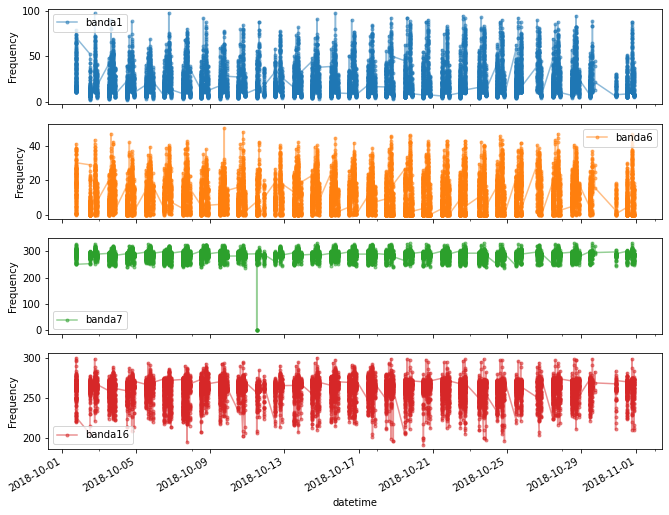

In [ ]:
cols_plot = ['banda1', 'banda6', 'banda7', 'banda16']
bands = ['banda1', 'banda2', 'banda3', 'banda4', 'banda5', 'banda6', 'banda7', 'banda8',
         'banda9', 'banda10', 'banda11', 'banda12','banda13', 'banda14', 'banda15', 'banda16']
axes = df[cols_plot].plot(marker='.', alpha=0.5, linestyle='-', figsize=(11, 9), subplots=True)
for ax in axes:
    ax.set_ylabel('Frequency')

**Observações das bandas considerando as estações de sondagens.**

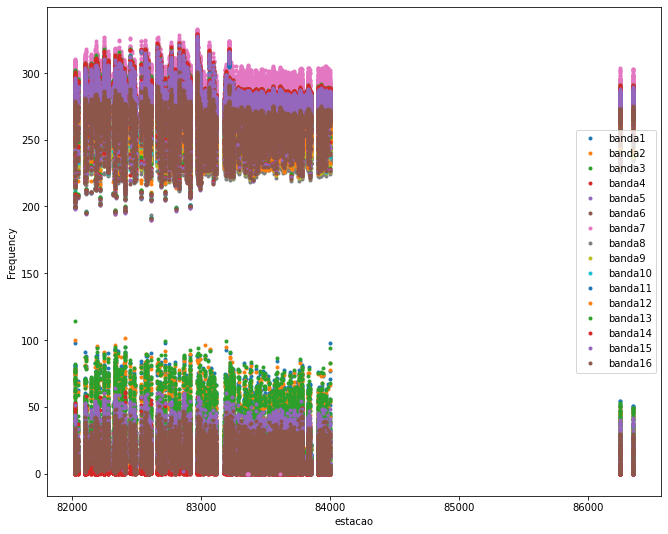

In [ ]:
df.plot(x="estacao", y=range(4, 20), figsize=(11, 9), ylabel = "Frequency", style='.');

**As medidas são discretizadas em algumas horas do dia. Por isso, há lacunas na série temporal.**

In [ ]:
# Number of occurrences for each hour
print("Seguem as horas do dia que imagens foram realizadas e a  quantidade de amostras para cada hora: \n", df['hour'].value_counts())
# Stations have different amount of data
#df['estacao'].value_counts()
print("\nHá " + str(len(df['estacao'].unique())) + " estações de imageamento de nuvens!")

Seguem as horas do dia que imagens foram realizadas e a  quantidade de amostras para cada hora: 
 12    6841
18    5805
21    1582
15    1514
Name: hour, dtype: int64

Há 252 estações de imageamento de nuvens!


In [ ]:
#df.loc['2018-10-01 12:00':'2018-10-31 12:00', 'banda4'].plot(figsize=(11,4), ylabel = "Frequency", marker='.', linestyle='-');
fig = px.line(df, x='datetime', y="banda4")
fig.show()

**Pode ser feita uma média diária para gerar séries temporais sem lacunas.**

In [ ]:
df_daily_mean = df.iloc[:, 4:20].resample("1d").mean()
data_table.DataTable(df_daily_mean, include_index=False, num_rows_per_page=10)

,banda1,banda2,banda3,banda4,banda5,banda6,banda7,banda8,banda9,banda10,banda11,banda12,banda13,banda14,banda15,banda16
datetime,,,,,,,,,,,,,,,,
2018-10-01,30.412582,25.628075,29.361549,3.295164,21.882629,17.735962,291.433662,237.475117,246.231831,253.940376,273.669624,251.589531,275.738592,275.130751,273.320516,261.251972
2018-10-02,19.026901,15.794250,18.280526,1.101715,13.935731,10.841969,287.061365,238.356530,248.133177,256.577739,276.090624,251.648187,278.118947,277.907524,276.384191,263.729630
2018-10-03,21.452080,18.106551,21.076586,2.381698,15.070537,12.396083,283.487296,234.869047,243.776360,252.074575,271.117071,248.181317,272.814194,272.227626,270.553813,259.158198
2018-10-04,18.159843,14.562474,17.240087,1.661951,13.116080,10.729756,286.659477,235.125453,244.109477,253.256672,275.107892,250.388659,277.143902,276.657021,274.821394,262.322997
2018-10-05,20.176261,16.823809,19.826052,1.397043,16.068574,13.023774,289.268104,236.773426,246.150087,255.428609,276.283878,252.109235,278.321739,277.833757,276.053200,263.784939
2018-10-06,23.805798,20.636507,23.645018,3.155816,16.226720,13.965426,284.107624,233.790000,241.716170,249.763298,269.202004,249.414238,271.098777,270.348528,268.495656,258.172394
2018-10-07,24.584463,21.085282,24.152678,4.423716,14.623807,13.114517,281.145974,234.927468,241.829417,248.091111,265.881949,247.182605,267.679836,266.657851,264.656302,254.672532
2018-10-08,19.718031,16.045453,19.083990,1.711341,13.942003,11.063850,287.596359,239.626411,247.992125,254.757561,275.213990,251.794774,277.523014,277.109564,275.133641,262.428240
2018-10-09,19.209021,15.676066,18.340000,1.827867,12.849283,10.300035,285.767185,239.024301,247.773584,254.557675,274.164021,250.833864,276.279528,275.886538,274.053934,261.518706




---


**Plotar histograma para banda3**

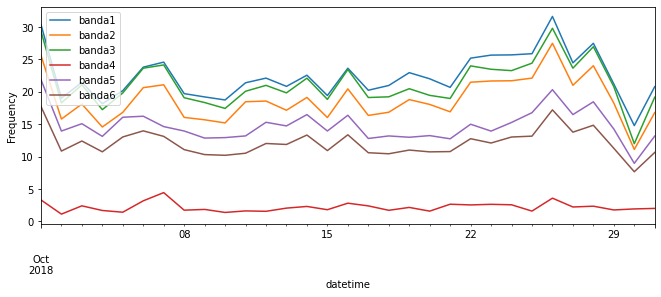

In [ ]:
df.iloc[:, 4:10].resample("1d").mean().plot(figsize=(11,4), ylabel = "Frequency");

Text(0.5, 0, 'Bins')

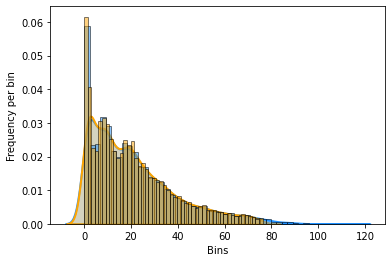

In [ ]:
#fig = ff.create_distplot([df.banda3.to_numpy()], ["banda3"], show_rug=False)
#fig.show()
kwargs = dict(hist_kws={'alpha':.5, 'edgecolor':'black'}, kde_kws={'linewidth':2, 'shade':True})
sns.distplot(df[['banda3']], bins=50, color="dodgerblue", hist=True, label="banda3", **kwargs);
sns.distplot(clearBySigma(df[['banda3']], 3), bins=50, color="orange", hist=True, label="banda3_cleaned", **kwargs);
plt.ylabel('Frequency per bin'); plt.xlabel('Bins')

Text(0.5, 0, 'Bins')

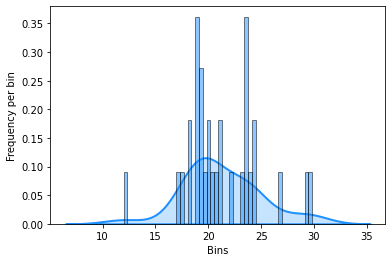

In [ ]:
#fig = ff.create_distplot([df_daily_mean.banda3.to_numpy()], ["banda3"], show_rug=False)
#fig.show()
sns.distplot(df_daily_mean[['banda3']], bins=50, color="dodgerblue", hist=True, label="banda3", **kwargs);
plt.ylabel('Frequency per bin'); plt.xlabel('Bins')

**Plotar histograma para banda13**

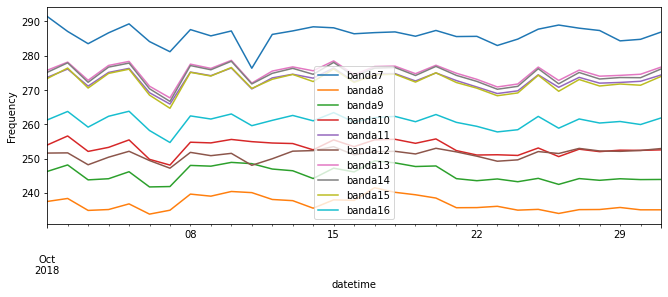

In [ ]:
df.iloc[:, 10:20].resample("1d").mean().plot(figsize=(11,4), ylabel = "Frequency");

Text(0.5, 0, 'Bins')

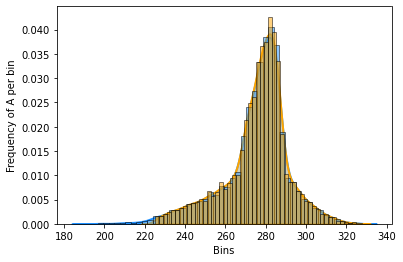

In [ ]:
sns.distplot(df[['banda13']], bins=50, color="dodgerblue", hist=True, label="banda13", **kwargs);
sns.distplot(clearBySigma(df[['banda13']], 3), bins=50, color="orange", hist=True, label="banda13_cleaned", **kwargs);
plt.ylabel('Frequency of A per bin'); plt.xlabel('Bins')

Text(0.5, 0, 'Bins')

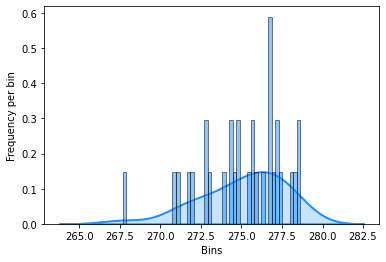

In [ ]:
sns.distplot(df_daily_mean[['banda13']], bins=50, color="dodgerblue", hist=True, label="banda13", **kwargs);
plt.ylabel('Frequency per bin'); plt.xlabel('Bins')

In [ ]:
fig = px.scatter(df, x="datetime", y="banda16", color="estacao", title="Time series for specific band");
fig.update_traces(mode="markers", hovertemplate=None)
fig.update_layout(hovermode="y"); fig.show()



---


**Classificar no espaço cullen-Frey e gerar histograma.**

In [ ]:
# In case its necessary to normalize all series create a scaler object, so fit and transform the data
scaler = MinMaxScaler()
dfnorm = pd.DataFrame(scaler.fit_transform(df[bands]), columns=df[bands].columns)
# Create a list with each timeserie band
seriesList = makeList(dfnorm, len(dfnorm['banda1']))
bandParams = getCFparams(seriesList, bands)
data_table.DataTable(bandParams, include_index=False, num_rows_per_page=10)

,kurtosis,skewness,type
0,4.654964,2.103806,banda1
1,4.587965,2.045847,banda2
2,4.035064,1.371168,banda3
3,32.542404,21.092310,banda4
4,3.379455,0.813727,banda5
5,2.873564,0.524473,banda6
6,60.076685,9.922043,banda7
7,4.746041,0.163001,banda8
8,5.337821,0.760680,banda9
9,6.153017,1.778775,banda10


In [ ]:
#maxIndex = np.argmax(bandParams['kurtosis'])
#cullenfrey(seriesList[maxIndex], bandParams)
#seriesList = makeList(df, len(df['banda1'])) # Descomente esta linha para o gráfico abranger todas as séries temporais
maxIndex = np.argmax(bandParams['kurtosis'])
cullenfreyPlotly(seriesList[maxIndex], bandParams)

Como pode ser visto na tabela anterior, as banda 4 e 7 estão fora dos limites considerados para o gráfico de Cullen-Frey produzido com a biblioteca plotly. Para observar essas bandas no gráfico é necessário passar como primeiro parâmetro a serie com maior kurtosi sem estar normalizada para a função cullenfreyPlotly.


In [ ]:
seriesList = makeList(df, len(df['banda1'])) # Descomente esta linha para o gráfico abranger todas as séries temporais
maxIndex = np.argmax(bandParams['kurtosis'])
cullenfreyPlotly(seriesList[maxIndex], bandParams)

Abaixo seguem os histogramas da maioria das séries temporais. Sendo que estas foram agrupadas, geralmente, considerando-se alguma proximidade de distribuição (PDF).

In [ ]:
bandseries = [df.banda9.to_numpy(), df.banda10.to_numpy(), df.banda11.to_numpy(), df.banda13.to_numpy(),
              df.banda14.to_numpy(), df.banda15.to_numpy(), df.banda16.to_numpy()]
names = ["banda9", "banda10", "banda11", "banda13", "banda14", "banda15", "banda16"]
#bandseries = [df.banda3.to_numpy()]; names = ["banda3"]
fig = ff.create_distplot(bandseries, names, show_rug=True); fig.show()

In [ ]:
bandseries = [df.banda1.to_numpy(), df.banda2.to_numpy(), df.banda3.to_numpy(),
              df.banda4.to_numpy(), df.banda5.to_numpy(), df.banda6.to_numpy()]
names = ["banda1", "banda2", "banda3", "banda4", "banda5", "banda6"]
fig = ff.create_distplot(bandseries, names, show_rug=True); fig.show()

In [ ]:
bandseries = [df.banda8.to_numpy(), df.banda12.to_numpy()]
names = ["banda8" , "banda12"]
fig = ff.create_distplot(bandseries, names, show_rug=True); fig.show()


---

# **Agrupamento de dados para gerar outras séries temporais**

In [ ]:
# Timeseries for days or hour considering stations
bandByDays = df.groupby(['day', 'estacao']).mean().reset_index()
bandByHours = df.groupby(['hour', 'estacao']).mean().reset_index()



---


## **Séries diárias**

No *dataframe bandByDays* foi realizada a operação de média diária para os valores de cada banda espectral que foram agrupados considerando as respectivas estações de sondagem. Ou seja, nos dados originais, cada estação possui medições para algumas horas do dia (12, 15, 18 e 21). Estes dados foram acumulados diáriamente para cada estação.

In [ ]:
data_table.DataTable(bandByDays, include_index=False, num_rows_per_page=10)

,day,estacao,latitude,longitude,banda1,banda2,banda3,banda4,banda5,banda6,banda7,banda8,banda9,banda10,banda11,banda12,banda13,banda14,banda15,banda16,hour
0,1,82022,2.83,-60.70,11.800000,8.340000,23.930000,0.060000,21.520000,10.220000,310.040000,250.560000,260.270000,267.640000,298.680000,276.120000,302.370000,300.750000,296.010000,278.650000,18.0
1,1,82024,2.82,-60.65,11.420000,7.550000,27.650000,0.000000,19.170000,11.960000,309.590000,250.510000,260.140000,267.690000,297.220000,274.850000,301.080000,299.500000,295.240000,278.370000,18.0
2,1,82096,0.52,-50.42,54.380000,51.680000,58.150000,0.120000,52.980000,37.070000,305.030000,237.080000,247.270000,257.910000,276.510000,255.750000,278.950000,279.330000,278.260000,267.190000,18.0
3,1,82098,0.03,-51.05,54.500000,50.190000,57.300000,0.120000,49.360000,38.440000,305.100000,237.250000,247.520000,258.960000,276.930000,256.030000,279.140000,279.930000,279.270000,268.240000,18.0
4,1,82099,0.05,-51.07,56.660000,56.760000,58.280000,0.120000,49.490000,38.060000,305.350000,237.370000,247.520000,258.860000,276.980000,256.030000,279.320000,279.990000,279.330000,268.240000,18.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7353,31,83971,-30.00,-51.18,13.636667,8.606667,8.036667,0.123333,7.140000,6.260000,290.506667,235.433333,245.123333,254.720000,280.943333,260.966667,283.766667,283.200000,280.643333,268.053333,17.0
7354,31,83980,-31.33,-54.10,8.295000,2.835000,1.285000,0.060000,0.615000,0.490000,290.520000,239.510000,248.520000,257.340000,285.740000,265.040000,288.875000,288.455000,285.555000,271.710000,15.0
7355,31,83997,-33.52,-53.35,11.405000,5.055000,4.950000,0.060000,3.915000,4.550000,287.655000,237.370000,246.655000,256.120000,281.125000,261.140000,283.990000,283.820000,281.895000,269.695000,15.0
7356,31,86246,-25.35,-54.45,7.770000,2.120000,0.770000,0.000000,0.250000,0.080000,289.856667,239.470000,249.016667,258.576667,285.916667,265.330000,288.990000,288.743333,286.063333,272.516667,17.0


**Abaixo seguem exemplos de possibilidades de séries temporais que podem ser filtradas do *dataframe bandByDays*.**

In [ ]:
fig = px.line(bandByDays, y='banda16', title="Bands summarized by days and stations",
              hover_name = 'estacao', hover_data=["day"], template = 'ggplot2')
fig.update_traces(mode="lines", connectgaps=False); fig.update_layout(hovermode="y"); fig.show()

In [ ]:
fig = px.line(bandByDays.query('estacao == 82022'), y='banda1', title="Band1 summarized by days for a specific station",
              hover_name = 'estacao', hover_data=["day"], template = 'ggplot2')
fig.update_traces(mode="lines", connectgaps=False); fig.update_layout(hovermode="y"); fig.show()

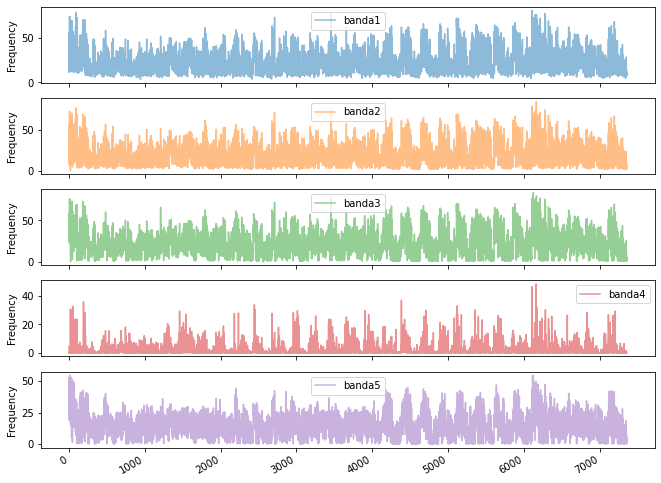

In [ ]:
axes = bandByDays[bands[0:5]].plot(alpha=0.5, linestyle='-', figsize=(11, 9), subplots=True)
for ax in axes: ax.set_ylabel('Frequency')

**Classificar no espaço cullen-Frey e gerar histograma.**

In [ ]:
# In case its necessary to normalize all series create a scaler object, so fit and transform the data
scaler = MinMaxScaler()
dfnorm = pd.DataFrame(scaler.fit_transform(bandByDays[bands]), columns=bandByDays[bands].columns)
# Create a list with each timeserie band
seriesList = makeList(dfnorm, len(dfnorm['banda1']))
bandParams = getCFparams(seriesList, bands)
data_table.DataTable(bandParams, include_index=False, num_rows_per_page=10)

,kurtosis,skewness,type
0,3.944082,1.336750,banda1
1,3.811737,1.230943,banda2
2,3.393564,0.695876,banda3
3,21.000557,13.162357,banda4
4,3.334833,0.318244,banda5
5,2.760094,0.159422,banda6
6,131.793956,37.948299,banda7
7,3.761955,0.007395,banda8
8,4.155994,0.266610,banda9
9,4.929469,0.937101,banda10


In [ ]:
#maxIndex = np.argmax(bandParams['kurtosis'])
#cullenfrey(seriesList[maxIndex], bandParams)
#seriesList = makeList(bandByDays, len(bandByDays['banda1'])) # Descomente esta linha para o gráfico abranger todas as séries temporais
maxIndex = np.argmax(bandParams['kurtosis'])
cullenfreyPlotly(seriesList[maxIndex], bandParams)

In [ ]:
fig = ff.create_distplot([bandByDays.banda3.to_numpy()], ["banda3"], show_rug=True); fig.show()

**Caracterização da não-gaussianidade espectral**

8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20
8192
20


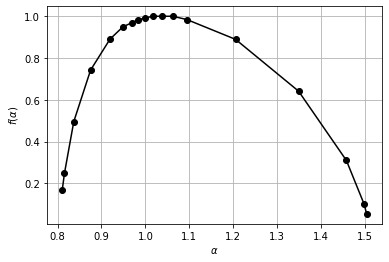

alpha_min = 0.810832, alpha_max = 1.50419, dalpha = 0.693355
h_min = 0.774271, h_max = 1.57008, dh = 0.795806



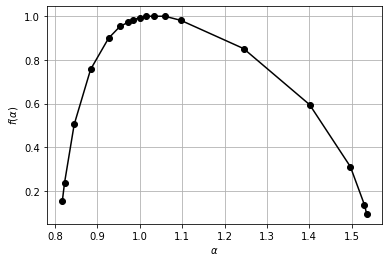

alpha_min = 0.817172, alpha_max = 1.5355, dalpha = 0.718324
h_min = 0.781145, h_max = 1.60396, dh = 0.822812



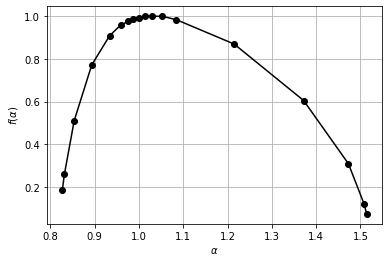

alpha_min = 0.826904, alpha_max = 1.51402, dalpha = 0.687111
h_min = 0.789928, h_max = 1.5811, dh = 0.791167



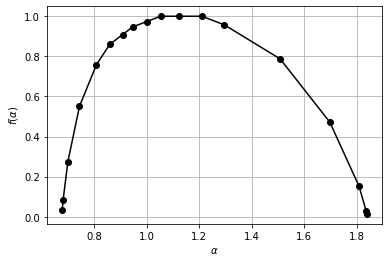

alpha_min = 0.678485, alpha_max = 1.83785, dalpha = 1.15936
h_min = 0.646152, h_max = 1.90124, dh = 1.25509



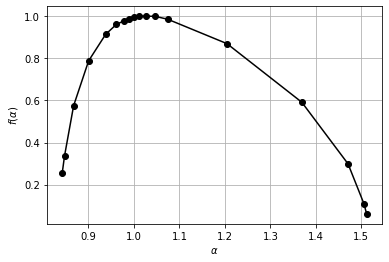

alpha_min = 0.842478, alpha_max = 1.51174, dalpha = 0.669266
h_min = 0.803179, h_max = 1.57805, dh = 0.774872



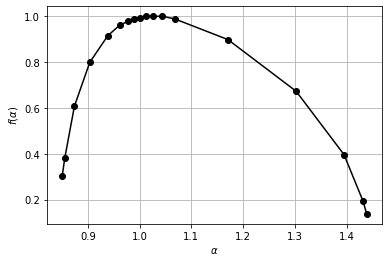

alpha_min = 0.850494, alpha_max = 1.43886, dalpha = 0.58837
h_min = 0.809727, h_max = 1.50997, dh = 0.700239



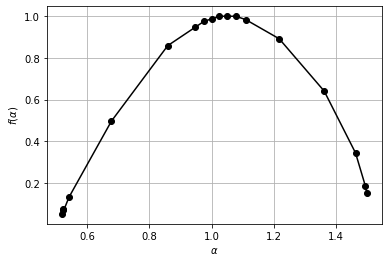

alpha_min = 0.521892, alpha_max = 1.49843, dalpha = 0.976535
h_min = 0.488241, h_max = 1.5705, dh = 1.08226



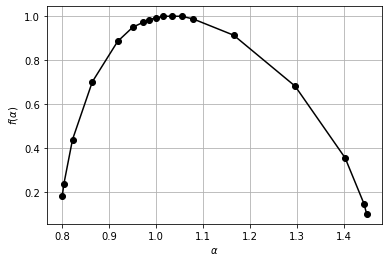

alpha_min = 0.799783, alpha_max = 1.4494, dalpha = 0.649613
h_min = 0.762801, h_max = 1.51821, dh = 0.75541



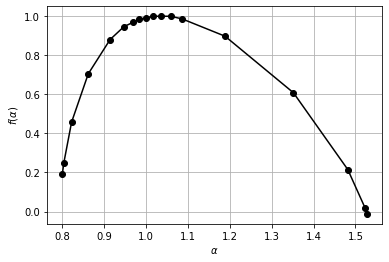

alpha_min = 0.799678, alpha_max = 1.52669, dalpha = 0.727016
h_min = 0.762476, h_max = 1.58844, dh = 0.825965



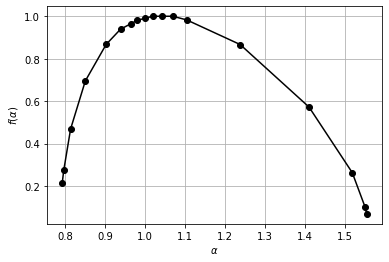

alpha_min = 0.793639, alpha_max = 1.55325, dalpha = 0.759615
h_min = 0.755625, h_max = 1.62007, dh = 0.864441



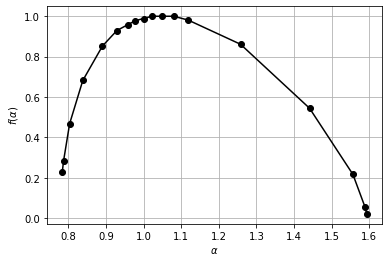

alpha_min = 0.784239, alpha_max = 1.59288, dalpha = 0.808638
h_min = 0.745806, h_max = 1.65674, dh = 0.910933



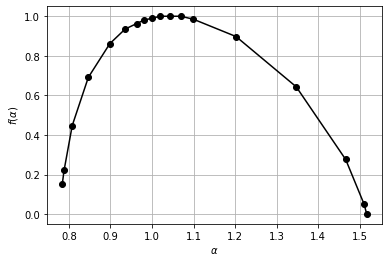

alpha_min = 0.783949, alpha_max = 1.51667, dalpha = 0.732719
h_min = 0.747914, h_max = 1.57927, dh = 0.831351



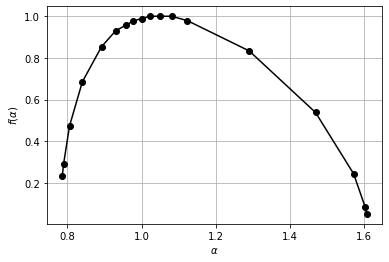

alpha_min = 0.786057, alpha_max = 1.60671, dalpha = 0.820652
h_min = 0.747472, h_max = 1.67241, dh = 0.924935



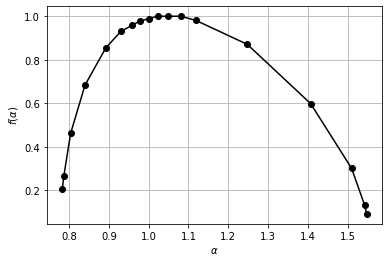

alpha_min = 0.783168, alpha_max = 1.54737, dalpha = 0.764202
h_min = 0.745531, h_max = 1.61558, dh = 0.870046



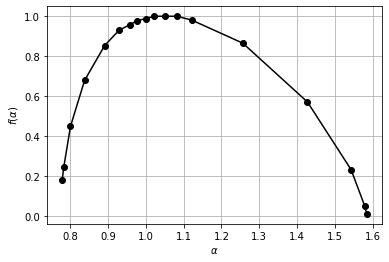

alpha_min = 0.779678, alpha_max = 1.58351, dalpha = 0.80383
h_min = 0.742667, h_max = 1.6468, dh = 0.904134



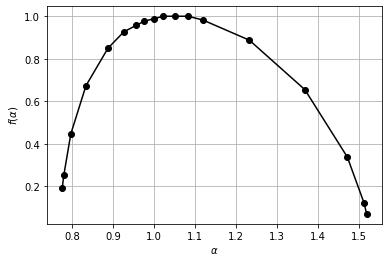

alpha_min = 0.776645, alpha_max = 1.51963, dalpha = 0.742985
h_min = 0.739375, h_max = 1.58646, dh = 0.847082



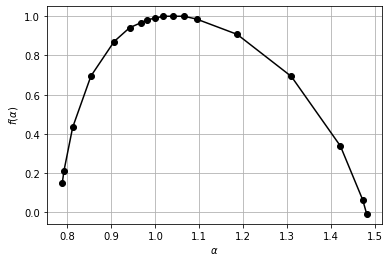

alpha_min = 0.788191, alpha_max = 1.4805, dalpha = 0.692312
h_min = 0.752235, h_max = 1.54249, dh = 0.790257



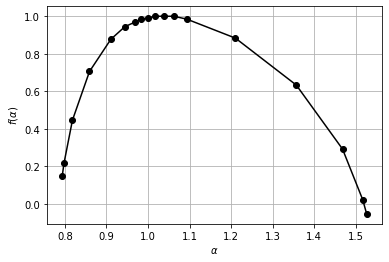

alpha_min = 0.793768, alpha_max = 1.52646, dalpha = 0.732695
h_min = 0.757816, h_max = 1.58558, dh = 0.827766



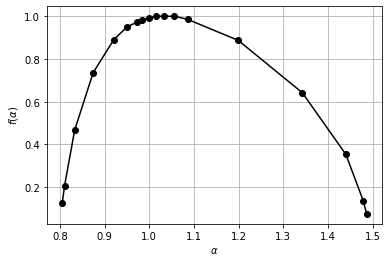

alpha_min = 0.805171, alpha_max = 1.48679, dalpha = 0.681615
h_min = 0.769993, h_max = 1.55395, dh = 0.783956



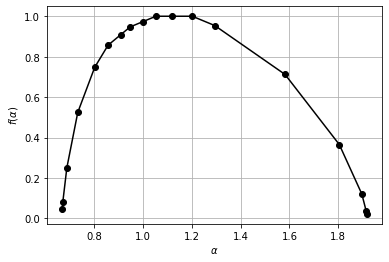

alpha_min = 0.669339, alpha_max = 1.91618, dalpha = 1.24684
h_min = 0.636632, h_max = 1.98008, dh = 1.34345



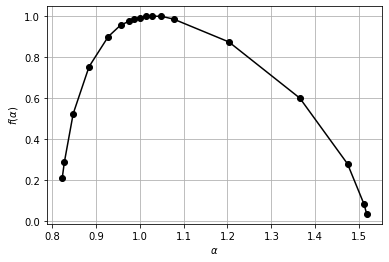

alpha_min = 0.823504, alpha_max = 1.51715, dalpha = 0.693645
h_min = 0.785663, h_max = 1.58172, dh = 0.796062



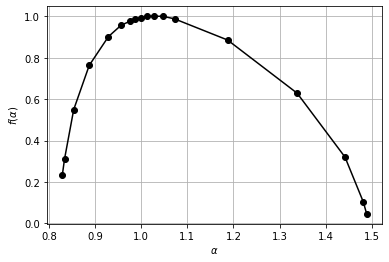

alpha_min = 0.829273, alpha_max = 1.48859, dalpha = 0.659313
h_min = 0.790753, h_max = 1.55393, dh = 0.763181



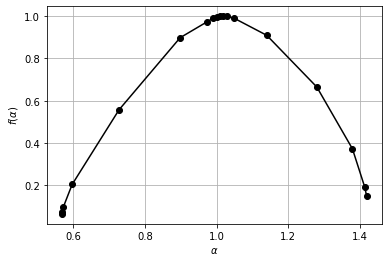

alpha_min = 0.569354, alpha_max = 1.41925, dalpha = 0.849899
h_min = 0.536098, h_max = 1.49101, dh = 0.954907



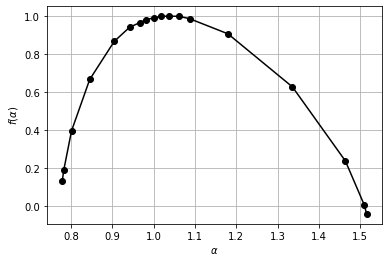

alpha_min = 0.779003, alpha_max = 1.51569, dalpha = 0.736684
h_min = 0.743565, h_max = 1.57569, dh = 0.832128



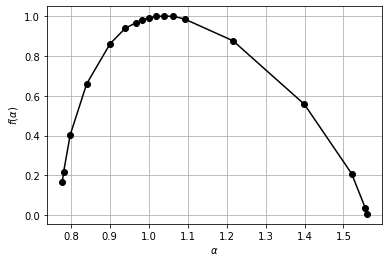

alpha_min = 0.778025, alpha_max = 1.55954, dalpha = 0.781513
h_min = 0.741648, h_max = 1.62242, dh = 0.880771



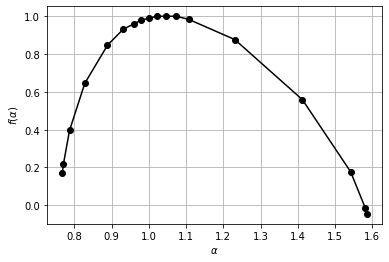

alpha_min = 0.767613, alpha_max = 1.58474, dalpha = 0.817124
h_min = 0.731053, h_max = 1.64439, dh = 0.913337



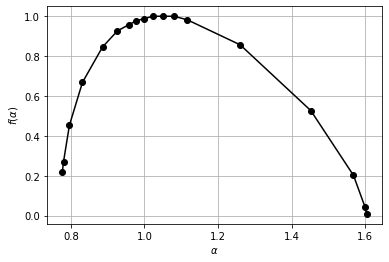

alpha_min = 0.77675, alpha_max = 1.60351, dalpha = 0.82676
h_min = 0.738732, h_max = 1.66652, dh = 0.927786



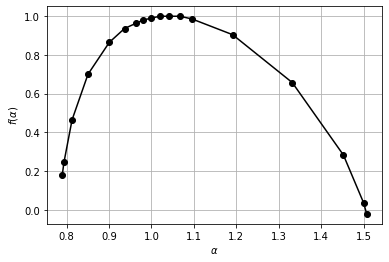

alpha_min = 0.790043, alpha_max = 1.50686, dalpha = 0.716822
h_min = 0.753126, h_max = 1.568, dh = 0.814871



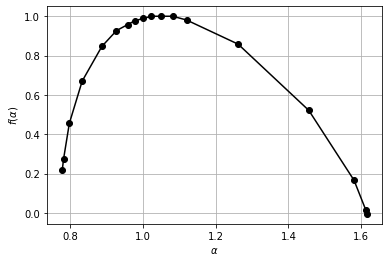

alpha_min = 0.777815, alpha_max = 1.615, dalpha = 0.837185
h_min = 0.739742, h_max = 1.67718, dh = 0.937433



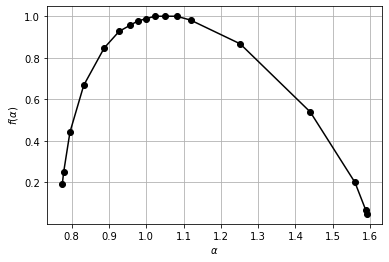

alpha_min = 0.774732, alpha_max = 1.5909, dalpha = 0.816173
h_min = 0.737507, h_max = 1.65642, dh = 0.91891



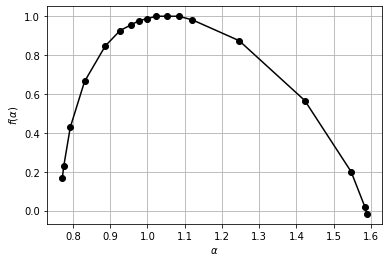

alpha_min = 0.771125, alpha_max = 1.5887, dalpha = 0.817573
h_min = 0.734674, h_max = 1.65011, dh = 0.915438



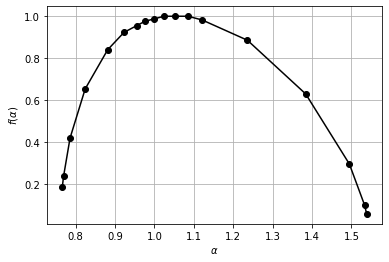

alpha_min = 0.766299, alpha_max = 1.53872, dalpha = 0.772421
h_min = 0.729298, h_max = 1.60472, dh = 0.875424



In [ ]:
seriesList = makeList(bandByDays[bands], 8192)
stypes = []
stypes.extend(bands)
seriesList, stypes = getDetrended(seriesList, stypes)
spectralParams = nonGaussianComplexity(seriesList, stypes)

In [ ]:
data_table.DataTable(spectralParams, include_index=False, num_rows_per_page=10)

,spectral,multispectral,complexity,type
0,0.348896,0.693355,0.776190,banda1
1,0.433040,0.718324,0.838757,banda2
2,0.389590,0.687111,0.789875,banda3
3,0.789583,1.159361,1.402697,banda4
4,0.352212,0.669266,0.756287,banda5
5,0.344890,0.588370,0.682003,banda6
6,0.075039,0.976535,0.979414,banda7
7,0.072672,0.649613,0.653665,banda8
8,0.073103,0.727016,0.730682,banda9
9,0.073534,0.759615,0.763166,banda10


In [ ]:
# Plotly px graph for non gaussian spectral complexity
fig = px.scatter(spectralParams, x="multispectral", y="spectral", color="type",
                 size = 'complexity', hover_name = 'type', template = 'ggplot2',
                 title="Non Gaussian Spectral Entropy");
fig.update_xaxes(rangemode="tozero", tickformat = '.2f')                
fig.update_yaxes(rangemode="tozero", tickformat = '.2f')
fig.update_layout(showlegend=False); fig.show()



---


## **Séries para cada hora disponível**

No *dataframe bandByHours* foi realizada a operação de média para os valores horários de cada banda espectral agrupados considerando as respectivas estações de sondagem. Lembrando que cada estação possui medições discretizadas em algumas horas do dia (12, 15, 18 e 21).

In [ ]:
data_table.DataTable(bandByHours, include_index=False, num_rows_per_page=10) 

,hour,estacao,latitude,longitude,banda1,banda2,banda3,banda4,banda5,banda6,banda7,banda8,banda9,banda10,banda11,banda12,banda13,banda14,banda15,banda16,day
0,12,82022,2.83,-60.70,23.315000,20.555357,29.651786,7.070714,15.135357,12.599286,286.505714,232.073929,239.433929,246.395000,267.607143,254.203214,269.416429,266.992143,263.704643,253.911429,15.678571
1,12,82024,2.82,-60.65,24.651786,22.528214,31.918929,6.561071,16.683571,13.673214,286.591071,232.606429,240.011786,247.019643,267.419643,253.929286,269.108571,266.936429,263.630357,254.257857,15.678571
2,12,82042,1.83,-61.13,21.091429,17.863214,23.198571,4.664643,12.863214,10.850714,289.442143,234.049286,242.044286,249.885000,273.512143,258.006071,275.591071,273.378571,269.862857,259.233214,15.678571
3,12,82096,0.52,-50.42,14.780800,11.549200,21.684400,1.623200,12.788800,10.148000,291.524400,238.559200,247.721200,256.312000,280.537600,258.445200,282.870800,282.150400,279.766400,266.133600,15.880000
4,12,82098,0.03,-51.05,17.823571,15.003571,23.356786,2.664643,15.623929,11.170000,289.860357,237.984286,246.586071,254.805000,278.444643,257.601786,280.637857,279.800000,277.446071,264.362500,15.678571
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583,21,83937,-29.72,-53.70,17.940370,13.828148,13.655556,1.463704,9.844815,8.551852,286.305556,238.306296,247.442963,256.104815,276.215556,254.839630,278.345185,277.900000,276.008889,264.378148,15.518519
584,21,83952,-29.93,-51.13,16.083704,11.403704,11.210741,1.120370,7.931111,6.729259,286.566296,238.094444,247.534074,255.952222,276.851852,253.999630,279.074815,278.763333,276.757037,264.355926,15.518519
585,21,83971,-30.00,-51.18,18.144815,15.029630,13.937407,1.387037,9.340000,7.150000,286.074815,237.820000,247.189259,255.502963,276.129259,253.522963,278.255926,277.833704,275.828519,263.531481,15.518519
586,21,86246,-25.35,-54.45,15.641481,11.157037,11.160741,1.619630,8.084074,8.084074,286.852593,240.531111,249.811481,257.958519,276.370370,255.988519,278.385926,277.823704,275.956296,264.747407,15.518519


**Abaixo seguem exemplos de possibilidades de séries temporais que podem ser filtradas do *dataframe bandByHours*.**

In [ ]:

fig = px.line(bandByHours, y="banda16", title="Bands summarized by Hours and stations",
               hover_name = 'estacao', hover_data=["hour"], template = 'ggplot2')
fig.update_traces(mode="lines", connectgaps=False)
fig.update_layout(hovermode="y"); fig.show()

In [ ]:

fig = px.line(bandByHours.query('estacao == 82022'), y="banda16", title="Band16 summarized by hours for a specific station",
               hover_name = 'estacao', hover_data=["hour"], template = 'ggplot2')
fig.update_traces(mode="lines", connectgaps=False)
fig.update_layout(hovermode="y"); fig.show()

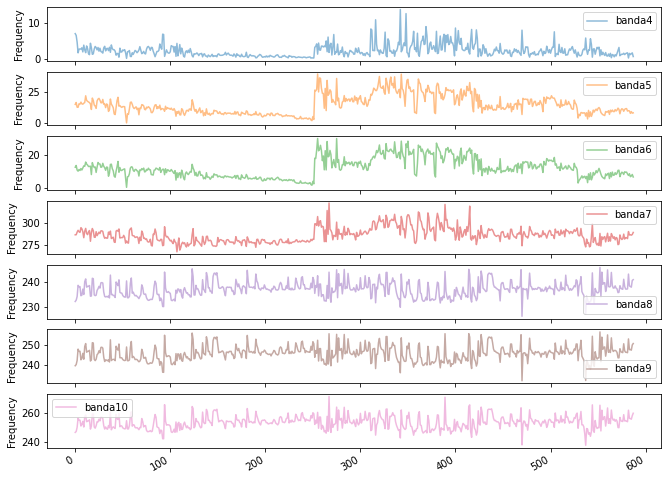

In [ ]:
axes = bandByHours[bands[3:10]].plot(alpha=0.5, linestyle='-', figsize=(11, 9), subplots=True)
for ax in axes:
    ax.set_ylabel('Frequency')

**Classificar no espaço cullen-Frey e gerar histograma.**

In [ ]:
# In case its necessary to normalize all series create a scaler object, so fit and transform the data
scaler = MinMaxScaler()
dfnorm = pd.DataFrame(scaler.fit_transform(bandByHours[bands]), columns=bandByHours[bands].columns)
# Create a list with each timeserie band
seriesList = makeList(dfnorm, len(dfnorm['banda1']))
bandParams = getCFparams(seriesList, bands)
data_table.DataTable(bandParams, include_index=False, num_rows_per_page=10)

,kurtosis,skewness,type
0,3.183256,0.329106,banda1
1,4.047391,0.717258,banda2
2,3.127782,0.672527,banda3
3,10.257237,4.812742,banda4
4,3.104625,0.687614,banda5
5,2.811755,0.451862,banda6
6,4.359367,0.965962,banda7
7,3.397235,0.098019,banda8
8,3.518760,0.077803,banda9
9,3.773268,0.113729,banda10


In [ ]:
#maxIndex = np.argmax(bandParams['kurtosis'])
#cullenfrey(seriesList[maxIndex], bandParams)
seriesList = makeList(bandByHours, len(bandByHours['banda1'])) # Descomente esta linha para o gráfico abranger todas as séries temporais
maxIndex = np.argmax(bandParams['kurtosis'])
cullenfreyPlotly(seriesList[maxIndex], bandParams)

In [ ]:
bandseries = [bandByHours.banda3.to_numpy(), bandByHours.banda4.to_numpy()]
fig = ff.create_distplot(bandseries, ["banda3", "banda4"], show_rug=True); fig.show()

**Caracterização da não-gaussianidade espectral**

512
8
512
8
512
8
512
8
512
8
512
8
512
8
512
8
512
8
512
8
512
8
512
8
512
8
512
8
512
8
512
8


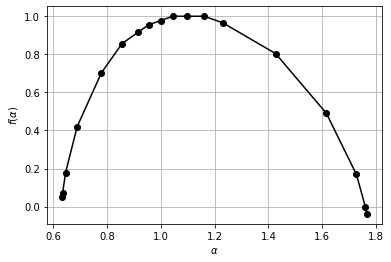

alpha_min = 0.634362, alpha_max = 1.76523, dalpha = 1.13087
h_min = 0.601482, h_max = 1.82534, dh = 1.22386



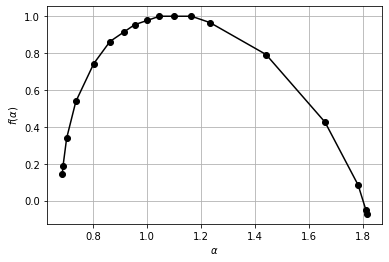

alpha_min = 0.686575, alpha_max = 1.81261, dalpha = 1.12604
h_min = 0.650836, h_max = 1.87061, dh = 1.21977



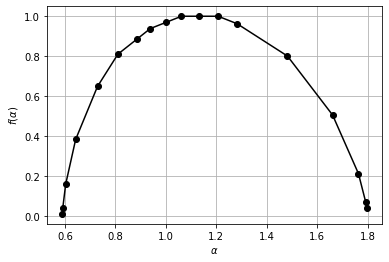

alpha_min = 0.589617, alpha_max = 1.79554, dalpha = 1.20592
h_min = 0.558063, h_max = 1.86053, dh = 1.30246



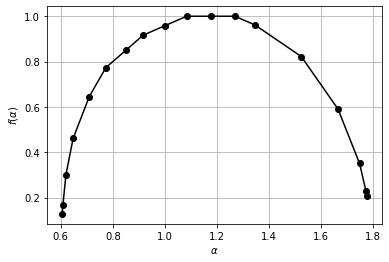

alpha_min = 0.605751, alpha_max = 1.77515, dalpha = 1.1694
h_min = 0.570501, h_max = 1.85058, dh = 1.28008



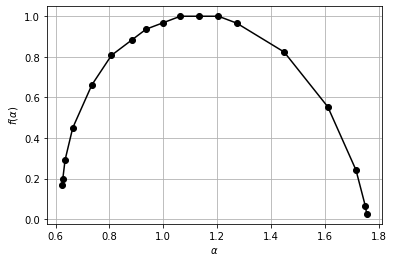

alpha_min = 0.624684, alpha_max = 1.75596, dalpha = 1.13127
h_min = 0.588124, h_max = 1.82009, dh = 1.23196



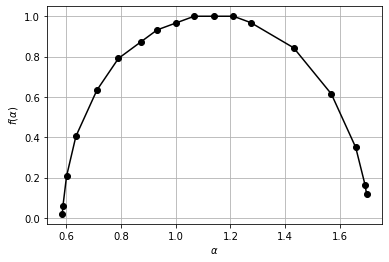

alpha_min = 0.585829, alpha_max = 1.69774, dalpha = 1.11191
h_min = 0.553949, h_max = 1.76753, dh = 1.21358



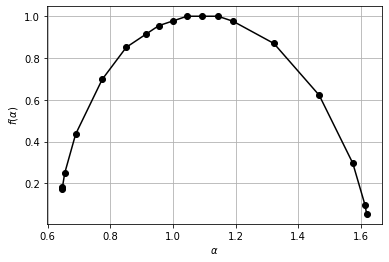

alpha_min = 0.647001, alpha_max = 1.61867, dalpha = 0.971672
h_min = 0.610359, h_max = 1.68452, dh = 1.07416



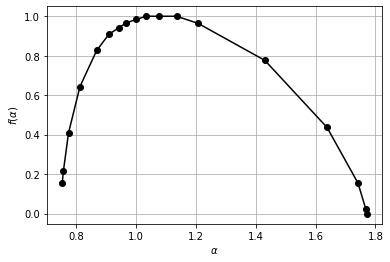

alpha_min = 0.752722, alpha_max = 1.77056, dalpha = 1.01784
h_min = 0.716562, h_max = 1.83296, dh = 1.1164



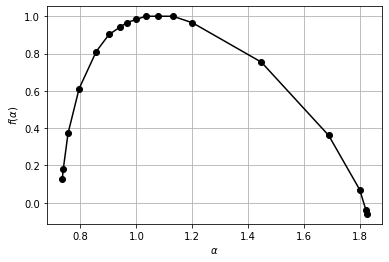

alpha_min = 0.73526, alpha_max = 1.82292, dalpha = 1.08766
h_min = 0.700113, h_max = 1.88167, dh = 1.18156



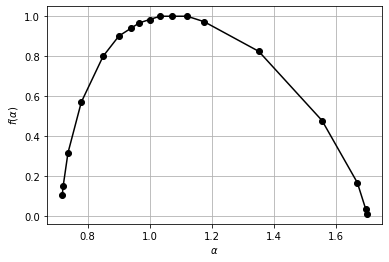

alpha_min = 0.718499, alpha_max = 1.69899, dalpha = 0.980488
h_min = 0.683999, h_max = 1.76205, dh = 1.07805



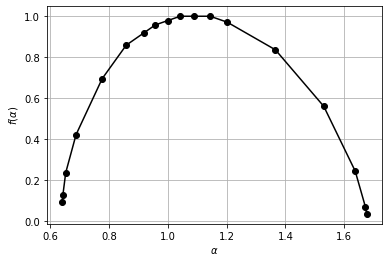

alpha_min = 0.641252, alpha_max = 1.67641, dalpha = 1.03516
h_min = 0.607039, h_max = 1.74107, dh = 1.13403



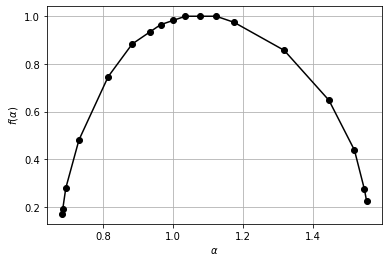

alpha_min = 0.683989, alpha_max = 1.55297, dalpha = 0.868984
h_min = 0.647407, h_max = 1.6294, dh = 0.981993



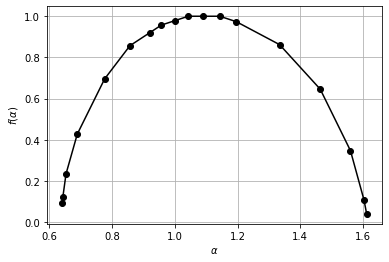

alpha_min = 0.641234, alpha_max = 1.6115, dalpha = 0.970264
h_min = 0.607096, h_max = 1.67647, dh = 1.06938



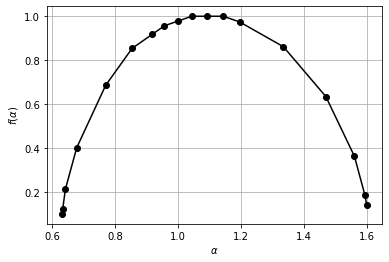

alpha_min = 0.632247, alpha_max = 1.59873, dalpha = 0.966478
h_min = 0.597825, h_max = 1.67015, dh = 1.07232



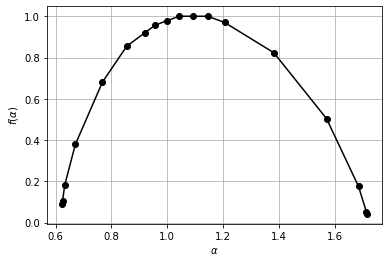

alpha_min = 0.623974, alpha_max = 1.7149, dalpha = 1.09093
h_min = 0.589925, h_max = 1.78004, dh = 1.19011



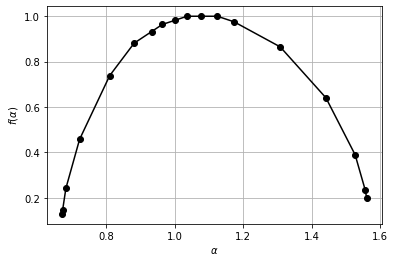

alpha_min = 0.671295, alpha_max = 1.56121, dalpha = 0.889915
h_min = 0.636006, h_max = 1.63621, dh = 1.00021



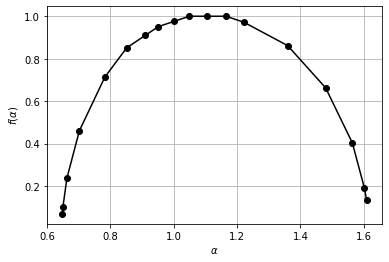

alpha_min = 0.647706, alpha_max = 1.60933, dalpha = 0.961626
h_min = 0.614307, h_max = 1.68012, dh = 1.06581



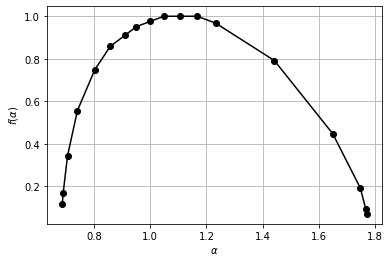

alpha_min = 0.687606, alpha_max = 1.76967, dalpha = 1.08206
h_min = 0.65267, h_max = 1.83658, dh = 1.18391



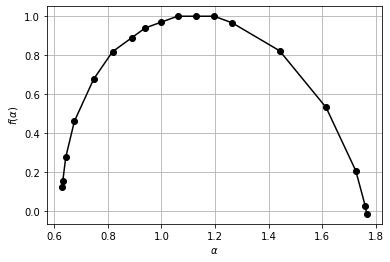

alpha_min = 0.630219, alpha_max = 1.76621, dalpha = 1.13599
h_min = 0.595144, h_max = 1.8277, dh = 1.23256



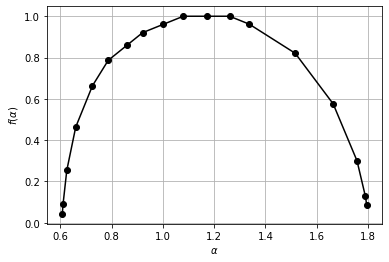

alpha_min = 0.60703, alpha_max = 1.7953, dalpha = 1.18827
h_min = 0.574447, h_max = 1.8633, dh = 1.28885



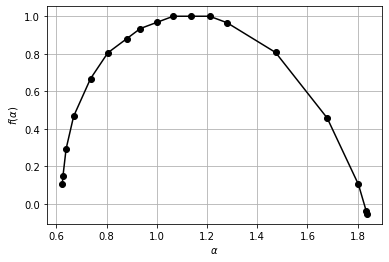

alpha_min = 0.623676, alpha_max = 1.83587, dalpha = 1.21219
h_min = 0.589153, h_max = 1.89503, dh = 1.30588



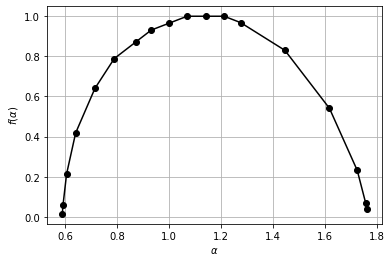

alpha_min = 0.58906, alpha_max = 1.75923, dalpha = 1.17017
h_min = 0.557364, h_max = 1.82407, dh = 1.26671



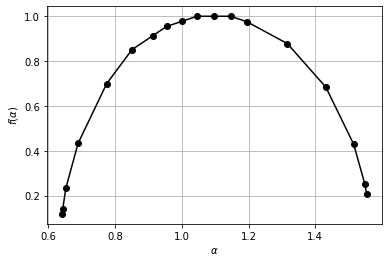

alpha_min = 0.642003, alpha_max = 1.55401, dalpha = 0.912004
h_min = 0.607066, h_max = 1.62944, dh = 1.02238



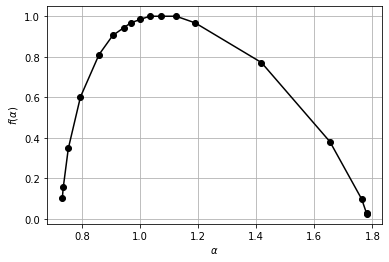

alpha_min = 0.731451, alpha_max = 1.78022, dalpha = 1.04877
h_min = 0.696997, h_max = 1.8443, dh = 1.14731



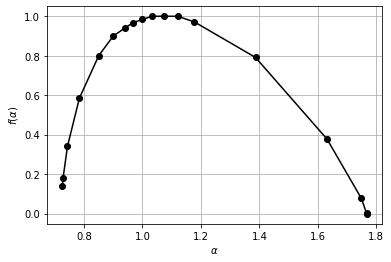

alpha_min = 0.725695, alpha_max = 1.76723, dalpha = 1.04153
h_min = 0.690126, h_max = 1.82963, dh = 1.1395



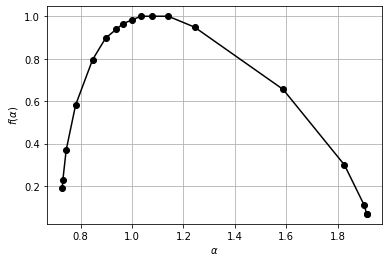

alpha_min = 0.72838, alpha_max = 1.91311, dalpha = 1.18473
h_min = 0.691125, h_max = 1.97988, dh = 1.28875



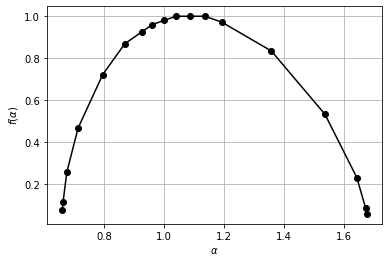

alpha_min = 0.660206, alpha_max = 1.675, dalpha = 1.01479
h_min = 0.626668, h_max = 1.74105, dh = 1.11438



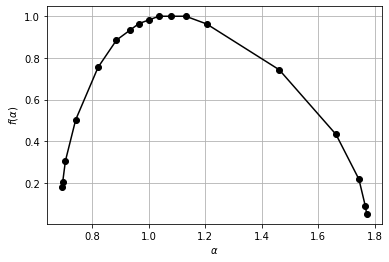

alpha_min = 0.693522, alpha_max = 1.77115, dalpha = 1.07763
h_min = 0.656629, h_max = 1.83684, dh = 1.18021



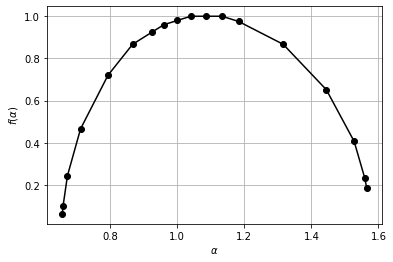

alpha_min = 0.656984, alpha_max = 1.56493, dalpha = 0.907941
h_min = 0.623798, h_max = 1.63907, dh = 1.01528



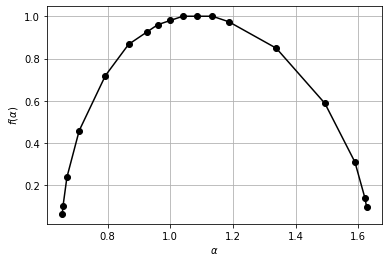

alpha_min = 0.655268, alpha_max = 1.62705, dalpha = 0.971783
h_min = 0.621997, h_max = 1.69556, dh = 1.07357



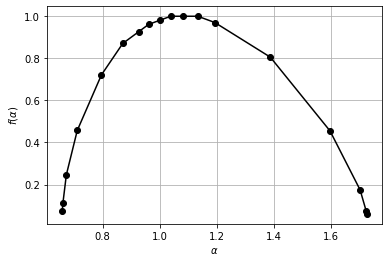

alpha_min = 0.658882, alpha_max = 1.72489, dalpha = 1.066
h_min = 0.625247, h_max = 1.79116, dh = 1.16591



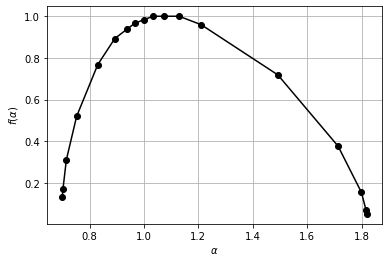

alpha_min = 0.700039, alpha_max = 1.8183, dalpha = 1.11827
h_min = 0.664724, h_max = 1.88396, dh = 1.21924



In [ ]:
seriesList = makeList(bandByHours[bands], 512)
stypes = []
stypes.extend(bands)
seriesList, stypes = getDetrended(seriesList, stypes)
spectralParams = nonGaussianComplexity(seriesList, stypes)

In [ ]:
data_table.DataTable(spectralParams, include_index=False, num_rows_per_page=10)

,spectral,multispectral,complexity,type
0,0.149215,1.130869,1.140671,banda1
1,0.189699,1.126038,1.141905,banda2
2,0.211617,1.205919,1.224346,banda3
3,0.443754,1.169395,1.250761,banda4
4,0.205713,1.131275,1.149826,banda5
5,0.189760,1.111910,1.127986,banda6
6,0.001732,0.971672,0.971674,banda7
7,0.000386,1.017840,1.017840,banda8
8,0.000540,1.087655,1.087655,banda9
9,0.000730,0.980488,0.980489,banda10


In [ ]:
# Plotly px graph for non gaussian spectral complexity
fig = px.scatter(spectralParams, x="multispectral", y="spectral", color="type",
                 size = 'complexity',hover_name = 'type', template = 'ggplot2',
                 title="Non Gaussian Spectral Entropy");
fig.update_xaxes(rangemode="tozero", tickformat = '.2f')                
fig.update_yaxes(tickformat = '.2f')
fig.update_layout(showlegend=False); fig.show()



---

PARTE B

**Estudo Comparativo com Modelo Estatístico Global de Perron-Sura**